# NYC Arrest Data Exploration

This notebook explores the NYC Arrest dataset which contains a breakdown of every NYPD arrest from the beginning od 2006 until the end of 2019. This exploration aims to help us better understand trends and patterns in NYC arrests.

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns; sns.set()

from datetime import datetime, date
import calendar

import warnings
warnings.filterwarnings("ignore")

In [2]:
PATH = "data/"
df = pd.read_csv(PATH + "NYPD_Arrests_Data__Historic_.csv", parse_dates=["ARREST_DATE"])

In [3]:
df.head()

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude
0,173130602,2017-12-31,566.0,"MARIJUANA, POSSESSION",678.0,MISCELLANEOUS PENAL LAW,PL 2210500,V,Q,105,0.0,25-44,M,BLACK,1063056.0,207463.0,40.735772,-73.715638
1,173114463,2017-12-31,478.0,"THEFT OF SERVICES, UNCLASSIFIED",343.0,OTHER OFFENSES RELATED TO THEFT,PL 1651503,M,Q,114,0.0,25-44,M,ASIAN / PACIFIC ISLANDER,1009113.0,219613.0,40.769437,-73.910241
2,173113513,2017-12-31,849.0,"NY STATE LAWS,UNCLASSIFIED VIOLATION",677.0,OTHER STATE LAWS,LOC000000V,V,K,73,1.0,18-24,M,BLACK,1010719.0,186857.0,40.679525,-73.904572
3,173113423,2017-12-31,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,18,0.0,25-44,M,WHITE,987831.0,217446.0,40.763523,-73.987074
4,173113421,2017-12-31,101.0,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,18,0.0,45-64,M,BLACK,987073.0,216078.0,40.759768,-73.989811


## Arrest Trends Over Time

First, we want to see the trend in the number of arrests being made over time since 2006. 

In [4]:
df["COUNT"] = 1

#Get the number of arrests for every day in the dataset
daily_arrests = df.groupby("ARREST_DATE", as_index=False).agg(len)[["ARREST_DATE", "COUNT"]]
daily_arrests.head()

,ARREST_DATE,COUNT
0,2006-01-01,551
1,2006-01-02,618
2,2006-01-03,899
3,2006-01-04,1229
4,2006-01-05,1383


In [5]:
#Extract the relevant date information from the arrest_date column
daily_arrests["MONTH"] = daily_arrests.ARREST_DATE.apply(lambda x: x.month)
daily_arrests["YEAR"] = daily_arrests.ARREST_DATE.apply(lambda x: x.year)
daily_arrests["WEEKDAY"] = daily_arrests.ARREST_DATE.apply(lambda x: x.day_name())
daily_arrests["MONTH_NAME"] = daily_arrests.ARREST_DATE.apply(lambda x: x.month_name())
daily_arrests["DAY_OF_MONTH"] = daily_arrests.ARREST_DATE.apply(lambda x: x.day)

avg_daily_arrests_by_month = daily_arrests.groupby(["YEAR", "MONTH"]).agg(np.mean)
avg_daily_arrests_by_month.head()

COUNT  DAY_OF_MONTH
YEAR MONTH                           
2006 1      1005.193548          16.0
     2      1034.357143          14.5
     3      1097.225806          16.0
     4      1021.200000          15.5
     5      1044.129032          16.0

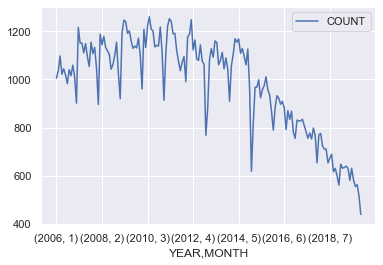

In [6]:
avg_daily_arrests_by_month.plot(y="COUNT");

As we can see, there was a slight uptick in the late 2000s, but there has been a steady decline in arrests since then. There is also clear seasonality in the data, which is apparent from the repeating peaks and valleys.

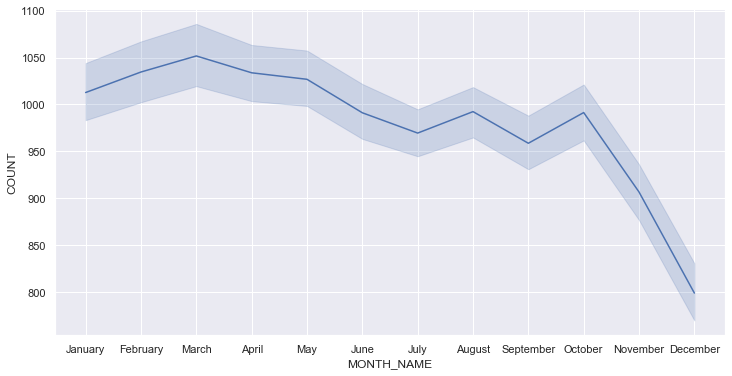

In [7]:
plt.figure(figsize=(12, 6))
sns.lineplot(x="MONTH_NAME", y="COUNT", data=daily_arrests, sort=False);

Here we see that arrests tend to decrease throughout the year. There seems to also be a major decrease in November and December. These may potentially because because of the colder winter season, or possibly because of the holiday season.

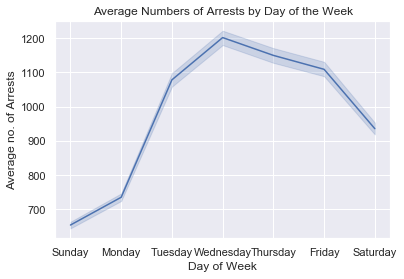

In [8]:
ax = sns.lineplot(x="WEEKDAY", y="COUNT", data=daily_arrests, sort=False);
ax.set_title("Average Numbers of Arrests by Day of the Week");
ax.set_ylabel("Average no. of Arrests");
ax.set_xlabel("Day of Week");

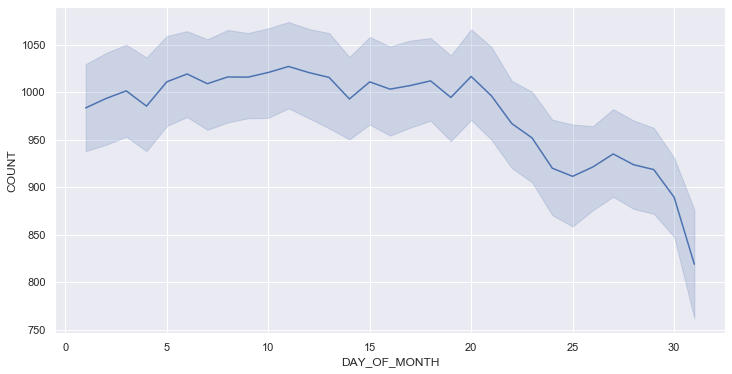

In [9]:
plt.figure(figsize=(12, 6))
sns.lineplot(x="DAY_OF_MONTH", y="COUNT", data=daily_arrests, sort=False);

Surprisingly, we see a dramatic decrease in arrests after the 20th day of the month. It's very likely that this is due to the holiday season, where the major holidays such as Thanksgiving, Christmas and New Year's Eve.

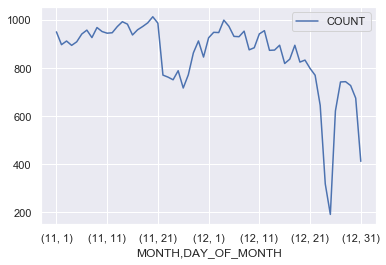

In [10]:
nov_dec_arrests = daily_arrests[daily_arrests["MONTH_NAME"].isin(["November", "December"])]
nov_dec_arrests = nov_dec_arrests.groupby(["MONTH", "DAY_OF_MONTH"]).agg(np.mean)[["COUNT"]]

nov_dec_arrests.plot();

This time-series plot shows us that the arrests clearly go down during Thanksgiving and in the days approching Christmas, shrinking to less than 1/4 of a typical day on Christmas day.

## Holidays

Next, we'll look at the effect that holiday and the holiday season have on the number of arrests.

In [11]:
import holidays

In [12]:
us_holidays = holidays.US()

def is_holiday(ts):
    return ts in us_holidays

In [13]:
holidays_df = daily_arrests[daily_arrests["ARREST_DATE"].apply(is_holiday)]
non_holidays_df = daily_arrests[daily_arrests["ARREST_DATE"].apply(is_holiday) == False]

print("Average arrests on holidays:" , holidays_df["COUNT"].mean())
print("Average arrests on non-holidays", non_holidays_df["COUNT"].mean())

Average arrests on holidays: 635.258064516129
Average arrests on non-holidays 991.2244856797096


Here we used the holidays library to filter the daily arrest data by weather or not that day was a holiday. There's a dramatic difference between numbers of arrests on holidays and non-holidays.

And now we'll look at the average number of arrests for each holiday.

In [14]:
holidays_df.loc[:, "Holiday"] = holidays_df.ARREST_DATE.map(us_holidays)
holidays_df.groupby("Holiday").agg(np.mean)[["COUNT"]].sort_values("COUNT")

,COUNT
Holiday,
Christmas Day,191.500000
Thanksgiving,278.000000
Christmas Day (Observed),465.000000
Memorial Day,555.000000
Labor Day,588.214286
New Year's Day (Observed),600.000000
New Year's Day,700.214286
Columbus Day,708.642857
Independence Day,736.357143


## Offenses

Next we'll try and break down the the most common types offenses and where they tend to occur.

In [15]:
#Correct inconsistent offense descriptions
offenses_correction = {"MURDER & NON-NEGL. MANSLAUGHTE": "MURDER & NON-NEGL. MANSLAUGHTER",
                       "LOITERING/GAMBLING (CARDS, DIC": 'LOITERING/GAMBLING (CARDS, DICE, ETC)',
                       'OFF. AGNST PUB ORD SENSBLTY &': 'OFF. AGNST PUB ORD SENSBLTY & RGHTS TO PRIV',
                       'HOMICIDE-NEGLIGENT,UNCLASSIFIE': 'HOMICIDE-NEGLIGENT,UNCLASSIFIED',
                       'INTOXICATED & IMPAIRED DRIVING': 'INTOXICATED/IMPAIRED DRIVING',
                       'OFFENSES AGAINST PUBLIC ADMINI': 'OFFENSES AGAINST PUBLIC ADMINISTRATION',
                       'OTHER OFFENSES RELATED TO THEF': 'OTHER OFFENSES RELATED TO THEFT',
                       'OTHER STATE LAWS (NON PENAL LA': 'OTHER STATE LAWS (NON PENAL LAW)'
                      }

def correct_offenses(offense):
    if offense in offenses_correction:
        return offenses_correction[offense]
    else:
        return offense

df["OFNS_DESC"] = df["OFNS_DESC"].apply(correct_offenses)

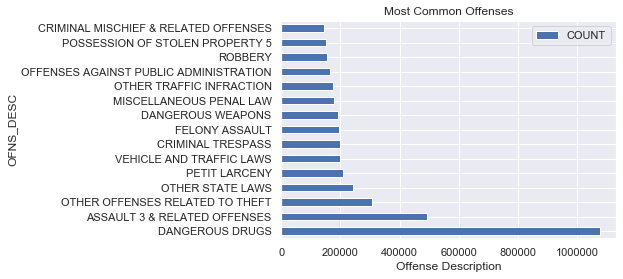

In [16]:
df["COUNT"] = 1
offenses_count = df[["OFNS_DESC", "COUNT"]].groupby("OFNS_DESC").agg(len)
ax = offenses_count.sort_values("COUNT", ascending=False).head(15).plot.barh()

ax.set_title("Most Common Offenses");
ax.set_xlabel("Offense Description");

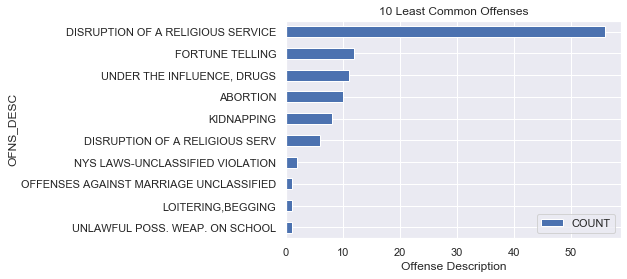

In [17]:
ax = offenses_count.sort_values("COUNT", ascending=True).head(10).plot.barh()

ax.set_title("10 Least Common Offenses");
ax.set_xlabel("Offense Description");

## Breaking Down Race and Sex

Since the dataset also contains demographic data, we can use those do determine which groups are most disproportionately arrested.

In [18]:
race_sex_crosstab = pd.crosstab(df.PERP_RACE, df.PERP_SEX) / df.shape[0]
race_sex_crosstab["Total"] = race_sex_crosstab["F"] + race_sex_crosstab["M"]

race_sex_crosstab.loc["Total"] = pd.Series([race_sex_crosstab["F"].sum(),
                                              race_sex_crosstab["M"].sum(),
                                              1.],
                                             index=["F", "M", "Total"])
race_sex_crosstab.loc["Black Total"] = race_sex_crosstab.loc["BLACK"] +\
                                          race_sex_crosstab.loc["BLACK HISPANIC"]

race_sex_crosstab.loc["Hispanic Total"] = race_sex_crosstab.loc["BLACK HISPANIC"] +\
                                             race_sex_crosstab.loc["WHITE HISPANIC"]

race_sex_crosstab

PERP_SEX,F,M,Total
PERP_RACE,,,
AMERICAN INDIAN/ALASKAN NATIVE,0.000329,0.001876,0.002204
ASIAN / PACIFIC ISLANDER,0.008764,0.032171,0.040935
BLACK,0.083760,0.401684,0.485444
BLACK HISPANIC,0.011031,0.069367,0.080398
OTHER,0.000026,0.000246,0.000272
UNKNOWN,0.001145,0.008898,0.010043
WHITE,0.022635,0.098031,0.120666
WHITE HISPANIC,0.040154,0.219884,0.260037
Total,0.167843,0.832157,1.000000


These are the racial demographics of NYC according to US Census Bureau estimates.

|Race and Hispanic Origin                        |     |
|------------------------------------------------|-----|
|White alone                                     |42.7%|
|Black or African American alone                 |24.3%|
|American Indian and Alaska Native Alone         |0.4% |
|Asian Alone                                     |13.9%|
|Native Hawaiian and Other Pacific Islander alone|0.1% |
|Two or More Races                               |3.5% |
|Hispanic or Latino                              |29.1%|
|White alone, not Hispanic or Latino             |32.1%|

Source: https://www.census.gov/quickfacts/newyorkcitynewyork

Using the Census bureau data, we can compare the arrest numbers of different racial groups to their share of the NYC population. The caveat here is that we're assuming that the Census Bureau and the NYC Government have the same definitions of different racial groups.

In [19]:
demo_perc = np.array([.004, .139, np.nan, np.nan, np.nan, np.nan, .321, .427 - .321, np.nan, .243, .291])

pd.DataFrame((race_sex_crosstab["Total"] / demo_perc).dropna()).sort_values("Total", ascending=False)

,Total
PERP_RACE,
WHITE HISPANIC,2.453181
Black Total,2.328570
Hispanic Total,1.169882
AMERICAN INDIAN/ALASKAN NATIVE,0.551072
WHITE,0.375906
ASIAN / PACIFIC ISLANDER,0.294496


The table above gives us the rates of arrest compared to the actual demographics of the city. Essential it answers the question: "How many times more likely is a person of a give race or hispanic origin to be arrested compared to the average person"? 

Somewhat surprisingly, White Hispanics seem to be the most disproportionately arrested group based on the NYPD's breakdown.

Next, we can look at which crimes were common within different racial groups.

In [20]:
#Get the number of offenses for each racial group
offenses_by_race = df[["PERP_RACE", "OFNS_DESC", "COUNT"]]\
                    .groupby(["PERP_RACE", "OFNS_DESC"]
                    , as_index=False).agg(np.sum).sort_values(["PERP_RACE", "COUNT"], ascending=False)

tot_arrests_by_ofns = df[["OFNS_DESC", "COUNT"]]\
                    .groupby(["OFNS_DESC"], as_index=False).agg(np.sum)
tot_arrests_by_ofns.set_index("OFNS_DESC", drop=False, inplace=True)

def get_offense_total(off):
    return tot_arrests_by_ofns.at[off, "COUNT"]

offenses_by_race["offense_total"] = offenses_by_race["OFNS_DESC"].apply(lambda x: get_offense_total(x))
offenses_by_race.set_index(["PERP_RACE", "OFNS_DESC"], inplace=True)
offenses_by_race["share_of_offense_total"] = offenses_by_race["COUNT"] / offenses_by_race["offense_total"]

#Take only offenses for which each racial group was arrested at least 1000 times
offenses_by_race = offenses_by_race[offenses_by_race["COUNT"] > 500]

In [21]:
#Get the rank of most distinctive crimes by race
rank = offenses_by_race.reset_index()\
        .groupby("PERP_RACE").rank(method='first', ascending=False)["share_of_offense_total"]

offenses_by_race["rank"] = np.array(rank).astype(int)

In [22]:
offenses_by_race[offenses_by_race["rank"] <= 3].sort_values(["PERP_RACE", "rank"]).drop("UNKNOWN")

COUNT  \
PERP_RACE                      OFNS_DESC                                     
AMERICAN INDIAN/ALASKAN NATIVE POSSESSION OF STOLEN PROPERTY 5         541   
                               OTHER TRAFFIC INFRACTION                591   
                               VEHICLE AND TRAFFIC LAWS                677   
ASIAN / PACIFIC ISLANDER       OFFENSES INVOLVING FRAUD               6852   
                               OFFENSES RELATED TO CHILDREN            703   
                               PROSTITUTION & RELATED OFFENSES        6802   
BLACK                          FRAUDULENT ACCOSTING                   1777   
                               LOITERING                               530   
                               ROBBERY                               94347   
BLACK HISPANIC                 GAMBLING                               1972   
                               F.C.A. P.I.N.O.S.                      1690   
                               ALCOHOLIC BEVERAGE CONTROL LAW          590   
WHITE                          OFFENSES AGAINST PUBLIC SAFETY          538   
                               INTOXICATED/IMPAIRED DRIVING          27286   
                               CRIMINAL MISCHIEF & RELATED OFFENSES  28495   
WHITE HISPANIC                 MOVING INFRACTIONS                     3198   
                               FORCIBLE TOUCHING                      3359   
                               RAPE                                   3903   

                                                                     offense_total  \
PERP_RACE                      OFNS_DESC                                             
AMERICAN INDIAN/ALASKAN NATIVE POSSESSION OF STOLEN PROPERTY 5              149877   
                               OTHER TRAFFIC INFRACTION                     174429   
                               VEHICLE AND TRAFFIC LAWS                     200292   
ASIAN / PACIFIC ISLANDER       OFFENSES INVOLVING FRAUD                      26146   
                               OFFENSES RELATED TO CHILDREN                   2684   
                               PROSTITUTION & RELATED OFFENSES               46634   
BLACK                          FRAUDULENT ACCOSTING                           2267   
                               LOITERING                                       720   
                               ROBBERY                                      153339   
BLACK HISPANIC                 GAMBLING                                      13410   
                               F.C.A. P.I.N.O.S.                             15917   
                               ALCOHOLIC BEVERAGE CONTROL LAW                 5688   
WHITE                          OFFENSES AGAINST PUBLIC SAFETY                 2047   
                               INTOXICATED/IMPAIRED DRIVING                 110542   
                               CRIMINAL MISCHIEF & RELATED OFFENSES         146039   
WHITE HISPANIC                 MOVING INFRACTIONS                             8261   
                               FORCIBLE TOUCHING                             10208   
                               RAPE                                          11914   

                                                                     share_of_offense_total  \
PERP_RACE                      OFNS_DESC                                                      
AMERICAN INDIAN/ALASKAN NATIVE POSSESSION OF STOLEN PROPERTY 5                     0.003610   
                               OTHER TRAFFIC INFRACTION                            0.003388   
                               VEHICLE AND TRAFFIC LAWS                            0.003380   
ASIAN / PACIFIC ISLANDER       OFFENSES INVOLVING FRAUD                            0.262067   
                               OFFENSES RELATED TO CHILDREN                        0.261923   
                               PROSTITUTION & RELATED OFFENSES                     0.145859   
BLACK                      

Above, we see the offenses for which different racial were most highly represented in the dataset.

## Understanding Where Arrests are Being Made

Here we'll use maps to better understand where arrests are being made in the city.

In [23]:
import folium
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [24]:
df_sample = df.sample(n=300000)

mid_city = [df.Latitude.mean(), df.Longitude.mean()]

First, we make a heat map of arrests throughout the city to get an idea of "hotspots".

In [25]:
heatmap = folium.Map(location=mid_city, tiles = "cartodbpositron", 
                     zoom_start=10)

HeatMap(data=df_sample[["Latitude", "Longitude"]].dropna(), radius=7).add_to(heatmap)

heatmap

Based on the map, it seems that the most concentrated spots are in Manhattan, The Bronx and Parts of Brooklyn. We can also use GIS data to visualize the arrests by specific borough.

In [26]:
import geopandas as gpd

In [27]:
nyc_boros = gpd.read_file(PATH + "Borough_Boundaries/geo_export_84a122ae-4139-4596-9175-c9b82e6080c2.shp")
nyc_boros = nyc_boros[["boro_name", "geometry"]].set_index("boro_name")

nyc_boros

,geometry
boro_name,
Bronx,"MULTIPOLYGON (((-73.89681 40.79581, -73.89694 ..."
Staten Island,"MULTIPOLYGON (((-74.05051 40.56642, -74.05047 ..."
Brooklyn,"MULTIPOLYGON (((-73.86706 40.58209, -73.86769 ..."
Queens,"MULTIPOLYGON (((-73.83668 40.59495, -73.83678 ..."
Manhattan,"MULTIPOLYGON (((-74.01093 40.68449, -74.01193 ..."


In [28]:
boro_dict = {"Q": "Queens",
            "K": "Brooklyn",
            "M": "Manhattan",
            "S": "Staten Island",
            "B": "Bronx"}

df["ARREST_BORO_FULL_NAME"] = df_sample["ARREST_BORO"].map(boro_dict)

In [29]:
boro_arrests = df["ARREST_BORO_FULL_NAME"].value_counts()

boro_map = folium.Map(location=mid_city, tiles = "cartodbpositron", 
                     zoom_start=10)

Choropleth(geo_data=nyc_boros.__geo_interface__,
          data=boro_arrests,
          key_on="feature.id",
          fill_color="YlGnBu",
          legend_name='Arrests by Burough').add_to(boro_map)
boro_map

Again, we see that manhattan and Brooklyn are the boroughs with the highest numbers of arrests. It may be more interesting though to break things down by precinct.

In [30]:
precincts = gpd.read_file(PATH + "Police_Precincts/geo_export_d5718fc8-ff01-47d3-8453-03b12f309423.shp")
precincts = precincts[["precinct", "geometry"]].set_index("precinct")
precincts.index = precincts.index.astype(int)

precincts.head()

,geometry
1,"MULTIPOLYGON (((-74.04388 40.69019, -74.04351 ..."
5,"POLYGON ((-73.98864 40.72293, -73.98869 40.722..."
6,"POLYGON ((-73.99968 40.73855, -73.99684 40.737..."
71,"POLYGON ((-73.92854 40.66457, -73.92872 40.664..."
72,"POLYGON ((-73.99841 40.67187, -73.99830 40.671..."


In [31]:
precinct_arrests = df[df["ARREST_PRECINCT"] != 27].ARREST_PRECINCT.value_counts()
precinct_arrests.index = precinct_arrests.index.astype(str)

precinct_map = folium.Map(location=mid_city, tiles = "cartodbpositron", 
                     zoom_start=10)

Choropleth(geo_data=precincts.__geo_interface__,
          data=precinct_arrests,
          key_on="feature.id",
          fill_color="YlGnBu",
          legend_name="Arrests by Precinct").add_to(precinct_map)

precinct_map

Here, we can more easily see that there are certain areas in the city where there are the highest concentrations of arrests being made.

As our last map, we'll make a bubble map which will show us the exact locations of arrests for different types of crimes. Here, we're showing only violent crimes. This is because there are way too many categories to effectively show them on one map. If we wanted to do that, we would need extremely broad categories, which may be suitable for some purposes.

In [32]:
common_offenses = df.OFNS_DESC.value_counts()[df.OFNS_DESC.value_counts() > 1000]

In [33]:
violent_crimes = {#Violent Crimes
                  "ASSAULT 3 & RELATED OFFENSES": "Assault",
                  "FELONY ASSAULT": "Assault",
                  "ROBBERY": "Robbery",
                  "MURDER & NON-NEGL. MANSLAUGHTER": "Homicide",
                  "RAPE": "Rape",
                  "KIDNAPPING & RELATED OFFENSES": "Kidnapping"
}

df_violent_crimes = df.copy()
df_violent_crimes["offense"] = df_violent_crimes["OFNS_DESC"].map(violent_crimes)
df_violent_crimes.dropna(inplace=True)

In [34]:
df_violent_crimes["YEAR"] = df_violent_crimes["ARREST_DATE"].apply(lambda x: x.year)
violent_crimes_2019 = df_violent_crimes[df_violent_crimes["YEAR"] == 2019]

In [35]:
offenses_map = folium.Map(location=mid_city,
                          tiles='cartodbpositron', zoom_start=11)

def color_producer(offense):
    if offense == "Assault":
        return 'forestgreen'
    elif offense == "Robbery":
        return 'orange'
    elif offense == "Homicide":
        return 'blue'
    elif offense == "Rape":
        return 'purple'
    elif offense == "Kidnapping":
        return 'red'

# Add a bubble map to the base map
for i in range(0, len(violent_crimes_2019)):
    Circle(
        location=[violent_crimes_2019.iloc[i]['Latitude'], violent_crimes_2019.iloc[i]['Longitude']],
        radius=20,
        color=color_producer(violent_crimes_2019.iloc[i]['offense'])).add_to(offenses_map)

# Display the map
offenses_map

The above map shows us how much more common assaults and roberries compared to other violent crimes. This visualization could be used in a dashboard to show how arrests have changed over time.

## 27<sup>th</sup> Precinct

While analyzing the arrests by precinct, I found a peculiar arrest record:

In [36]:
df[df["ARREST_PRECINCT"] == 27]

,ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,COUNT,ARREST_BORO_FULL_NAME
3986591,32311380,2007-06-18,511.0,"CONTROLLED SUBSTANCE, POSSESSION 7",235.0,DANGEROUS DRUGS,PL 2200300,M,Q,27,1.0,18-24,M,BLACK,NaN,NaN,NaN,NaN,1,NaN


This arrest shows an arrest in the the 27<sub>th</sub> precinct in Queens. However, a quick Google search shows that the 27th prectinct doesn't exist. This may be a typo, or it may mean something fishy is going on...

Thank you for reading!